# First checkpoint

In [1]:
# PATH = "drive/MyDrive/mgr/diffusion/result_path_jupyter/shared"
PATH = ".." # local
# DATA_DIR = "result_path_jupyter/data"
DATA_DIR = "data" # local

In [ ]:

# from google.colab import drive
# drive.mount('/content/drive/')

In [8]:
# !ls $PATH/result_path_jupyter/data

cache  gen_1


In [ ]:
# !pip install diffusers transformers accelerate datasets

In [1]:
import os

import matplotlib.pyplot as plt
import pandas as pd
import torch
import torchvision.transforms as transforms
from datasets import load_dataset
from diffusers import StableDiffusionPipeline
from PIL import Image
from torch.utils.data import DataLoader
from torchmetrics.image.fid import FrechetInceptionDistance
from tqdm import tqdm
from PIL import Image
import requests

## Save samples

In [13]:
def save_img(start_id: int, imgs: list[Image.Image], dir: str):
    for i, img in enumerate(imgs):
        path = os.path.join(PATH, DATA_DIR, dir, f"{i+start_id}.png")
        img.save(path)


def generate_images(
    model: StableDiffusionPipeline, ds, batch_size=16, start=0, dir="gen_1"
):
    for i in tqdm(range(start, ds.num_rows, batch_size)):
        prompts = ds["caption"][i : i + batch_size]
        imgs = model(prompt=prompts).images
        save_img(i, imgs, dir)

In [26]:
def to_tensor(examples):
    examples["image"] = [transform(image.convert("RGB")) for image in examples["image"]]
    return examples

ds = load_dataset("mprzymus/text2tile_large")
ds.set_transform(to_tensor)

transform = transforms.Compose([transforms.ToTensor()])
dl = DataLoader(ds["image"], batch_size=64)
dl.batch_size

64

In [39]:
def count_fidelity(dir: str, dataloader: DataLoader):
    path = os.path.join(PATH, DATA_DIR, dir)
    fid = FrechetInceptionDistance(normalize=True)
    for i, imgs in enumerate(tqdm(dataloader)):
        gen_imgs = []
        for j in range(imgs.shape[0]):
            img_number = dl.batch_size * i + j
            img_path = os.path.join(path, f"{img_number}.png")
            gen_imgs.append(transform(Image.open(img_path)))
        gen_imgs = torch.stack(gen_imgs)
        fid.update(imgs, real=True)
        fid.update(gen_imgs, real=False)
    return fid.compute()

In [41]:

count_fidelity("gen_2", dl)

100%|██████████| 65/65 [07:02<00:00,  6.49s/it]


tensor(45.1611)

In [ ]:
count_fidelity("gen_1", dl)

# City comparison

In [22]:
!mkdir ../results/

In [2]:
# prompts = [
#     "6 building retails , 37 building residentials , 14 buildings , 7 highway services , 1 landuse religious.",
#     "3 highway footways , 3 amenity parking spaces , 3 building apartmentss , 12 buildings , 1 building school.",
#     "1 waterway stream, 1 sport swimming, 3 highway cycleways , 3 leisure pitchs , 7 amenity parkings .",
#     "2 leisure playgrounds , 12 highway living streets , 1 amenity school, 4 highway tracks , 2 amenity benchs .",
#     "1 building apartments, 2 highway footways , 15 highway residentials , 157 buildings , 1 amenity bench."
# ]

In [3]:
pipe = StableDiffusionPipeline.from_pretrained("mprzymus/map_diffusion", safety_checker=None).to("cuda")

vae/diffusion_pytorch_model.safetensors not found
The config attributes {'force_upcast': True} were passed to AutoencoderKL, but are not expected and will be ignored. Please verify your config.json configuration file.
The config attributes {'addition_time_embed_dim': None, 'num_attention_heads': None, 'transformer_layers_per_block': 1} were passed to UNet2DConditionModel, but are not expected and will be ignored. Please verify your config.json configuration file.
You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior o

In [13]:
from functional import seq

def generate_samples_for_prompts(dir="../results/"):
    exists = os.listdir(dir)
    with open("../data/cities.txt", "r") as cities_file:
        for city in tqdm(cities_file):
            city = city.replace("\n", "")
            if city in exists:
                continue
            for i in range(2):
                geocode = pd.read_json(
                    f"../data/tiles_own/{city}/metadata.jsonl", lines=True, nrows=1
                )
                geocode = geocode["geocode"].item()
                city_prompt = (
                    seq(prompts)
                    .map(lambda x: f"OSM from {geocode} of city area containing: {x}")
                    .to_list()
                )
                images = pipe(prompt=city_prompt, num_images_per_prompt=1).images
                for p, img in zip(city_prompt, images):
                    city_path = os.path.join(dir, city)
                    os.makedirs(city_path, exist_ok=True)
                    img.save(f"{city_path}/{p}_{i}.png")
                    del img

In [14]:
def compare_area_types(prompt_template, to_put):
    for area_type in to_put:
        imgs = pipe(prompt=prompt_template.format(area_type=area_type), num_images_per_prompt=4).images
        fig = plt.figure(figsize=(15, 7))

        for i in range(len(imgs)):
            fig.add_subplot(1, len(imgs), i+1)
            plt.imshow(imgs[i])
            plt.axis('off')
        fig.suptitle(area_type.upper(), fontsize=30)
        plt.show()

# Data examples

In [4]:
from srai.regionizers import SlippyMapRegionizer

def get_data(long, lat):
    x, y = SlippyMapRegionizer(zoom=16)._coordinates_to_x_y(long, lat)
    return f"{x}_{y}_16", f"https://www.openstreetmap.org/#map=16/{long}/{lat}", f"https://tile.openstreetmap.de/16/{x}/{y}.png"

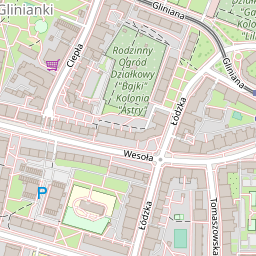

('35869_21913_16',
 'https://www.openstreetmap.org/#map=16/51.0899/17.0396',
 'https://tile.openstreetmap.de/16/35869/21913.png')

In [5]:
#huby
wroclaw = get_data(51.0899, 17.0396)
display(Image.open(requests.get(wroclaw[2], stream=True).raw))
wroclaw

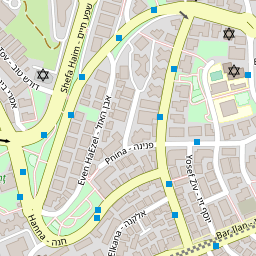

('39178_26657_16',
 'https://www.openstreetmap.org/#map=16/31.7946/35.2152',
 'https://tile.openstreetmap.de/16/39178/26657.png')

In [6]:
# na oko wszystko podobnie, jeruzalem jest ciekawe
jerusalem = get_data(31.7946, 35.2152)
display(Image.open(requests.get(jerusalem[2], stream=True).raw))
jerusalem

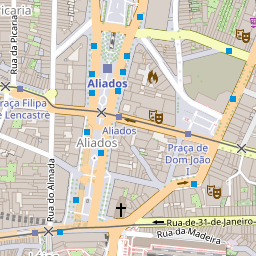

('31200_24535_16',
 'https://www.openstreetmap.org/#map=16/41.14785/-8.61118',
 'https://tile.openstreetmap.de/16/31200/24535.png')

In [7]:
# centrum miasta, porto jest ciekawym miastem ze względu na szerokie ulice
porto = get_data(41.14785, -8.61118)
display(Image.open(requests.get(porto[2], stream=True).raw))
porto

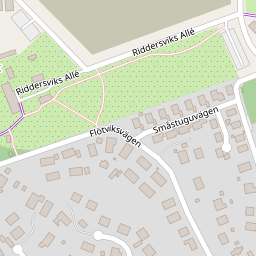

('36008_19255_16',
 'https://www.openstreetmap.org/#map=16/59.37955/17.7991',
 'https://tile.openstreetmap.de/16/36008/19255.png')

In [8]:
# obrzeża, plac zabaw
stockholm = get_data(59.37955, 17.79910)
display(Image.open(requests.get(stockholm[2], stream=True).raw))
stockholm

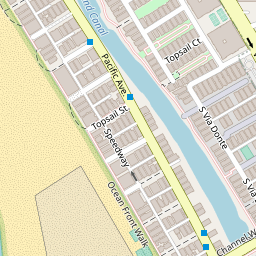

('11203_26186_16',
 'https://www.openstreetmap.org/#map=16/33.9677/-118.4557',
 'https://tile.openstreetmap.de/16/11203/26186.png')

In [9]:
# nadbrzeże
la = get_data(33.9677, -118.4557)
display(Image.open(requests.get(la[2], stream=True).raw))
la

In [10]:
from map_generation.osm_dataset import create_sentence
import pandas as pd

def get_sentence(city: str, img_id, replace_city_with=None):
    df = pd.read_json(f"../data/tiles_own/{city}/metadata.jsonl", lines=True)
    item = df[df["file_name"] == f"{img_id}.png"].squeeze()
    string = create_sentence(item, n_columns=10)
    city = item["geocode"]
    if replace_city_with is not None:
        string = string.replace(city, replace_city_with)
    return string

def get_city_name(city: str):
    df = pd.read_json(f"../data/tiles_own/{city}/metadata.jsonl", lines=True)
    item = df.iloc[0]
    city = item["geocode"]
    return city

In [11]:
to_replace = "{area_type}"
sentences = [
    get_sentence("Wrocław, PL", wroclaw[0], to_replace),
    get_sentence("Jerusalem, Izrael", jerusalem[0], to_replace),
    get_sentence("Porto, Portugal", porto[0], to_replace),
    get_sentence("Stockholm, Sweden", stockholm[0], to_replace),
    get_sentence("Los Angeles, USA", la[0], to_replace),
]
cities = [
    get_city_name("Wrocław, PL"),
    get_city_name("Jerusalem, Izrael"),
    get_city_name("Porto, Portugal"),
    get_city_name("Stockholm, Sweden"),
    get_city_name("Los Angeles, USA"),
    
]

sentences


['OSM from {area_type} of suburb area containing: 4 highway turning circles , 27 highway paths , 3 sport basketballs , 11 highway residentials , 1 shop alcohol, 1 amenity veterinary, 173 highway footways , 3 amenity recyclings , 1 building garages, 12 building roofs .',
 'OSM from {area_type} of city area containing: 54 highway tertiarys , 3 highway stepss , 6 amenity schools , 184 buildings , 1 landuse residential, 26 highway residentials , 13 highway services , 5 amenity place of worships , 44 highway footways , 1 leisure pitch.',
 'OSM from {area_type} of suburb area containing: 1 shop variety store, 16 shop jewelrys , 1 office estate agent, 458 buildings , 11 landuse meadows , 1 office political party, 1 building church, 15 amenity bars , 1 office diplomatic, 4 shop doityourselfs .',
 'OSM from {area_type} of suburb area containing: 1 leisure garden, 2 amenity parking spaces , 11 building sheds , 1 amenity events venue, 3 highway turning circles , 2 highway unclassifieds , 2 highwa

OSM from {area_type} of suburb area containing: 4 highway turning circles , 27 highway paths , 3 sport basketballs , 11 highway residentials , 1 shop alcohol, 1 amenity veterinary, 173 highway footways , 3 amenity recyclings , 1 building garages, 12 building roofs .


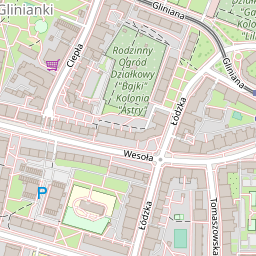

  0%|          | 0/50 [00:00<?, ?it/s]

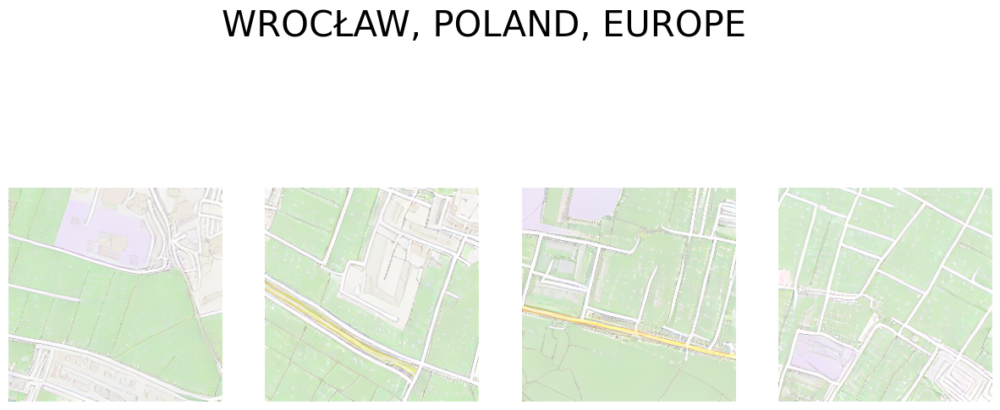

  0%|          | 0/50 [00:00<?, ?it/s]

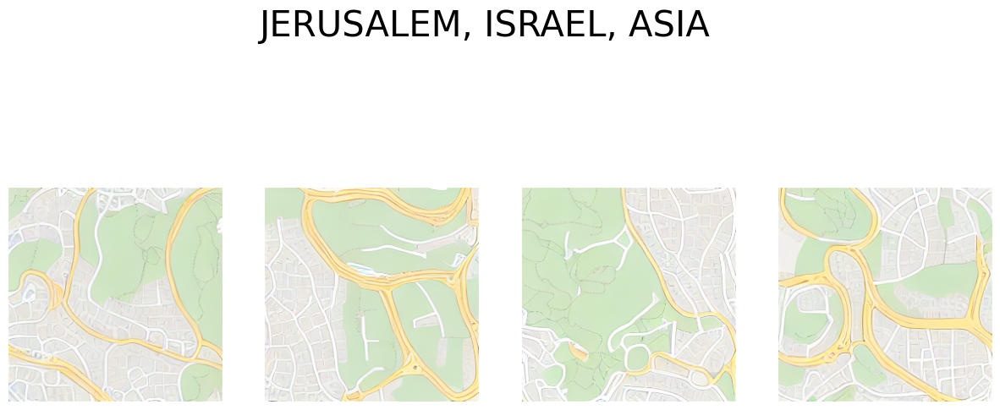

  0%|          | 0/50 [00:00<?, ?it/s]

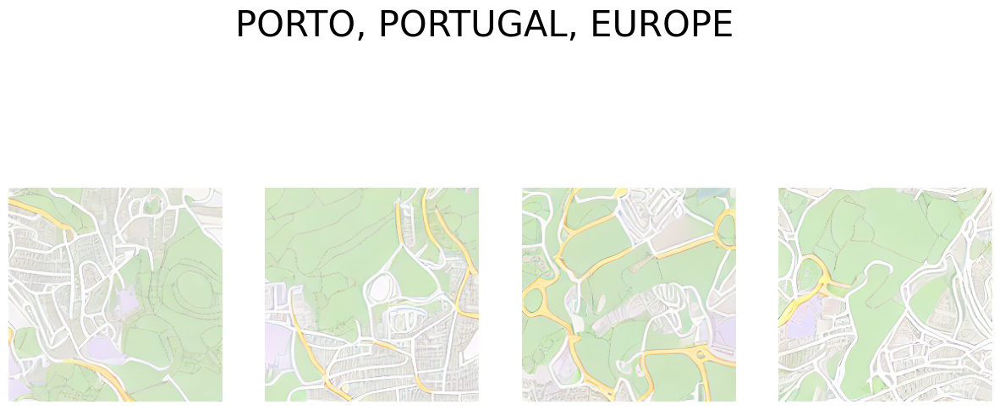

  0%|          | 0/50 [00:00<?, ?it/s]

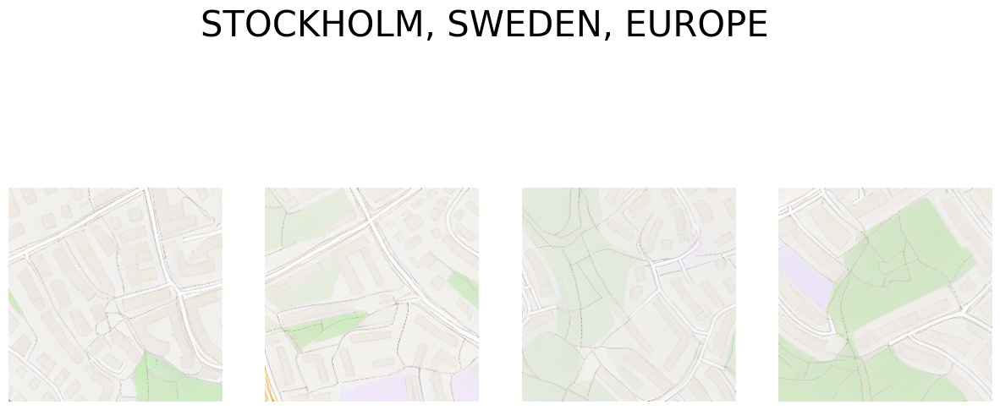

  0%|          | 0/50 [00:00<?, ?it/s]

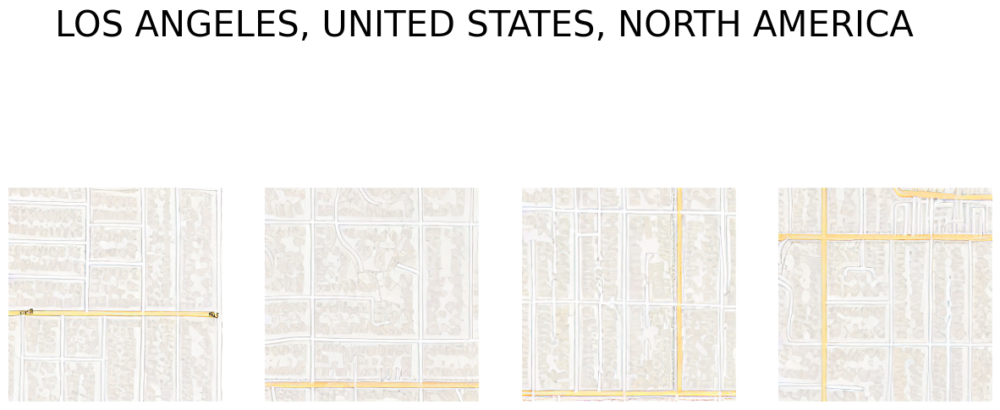

In [15]:
print(sentences[0])
display(Image.open(requests.get(wroclaw[2], stream=True).raw))
compare_area_types(sentences[0], cities)

OSM from {area_type} of city area containing: 2 railway constructions , 5 amenity place of worships , 1 highway track, 10 leisure parks , 6 amenity schools , 1 landuse meadow, 184 buildings , 54 highway tertiarys , 19 highway crossings , 13 highway services .


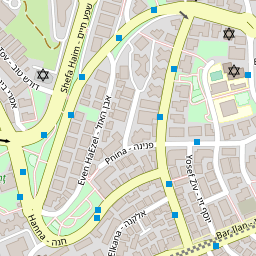

  0%|          | 0/50 [00:00<?, ?it/s]

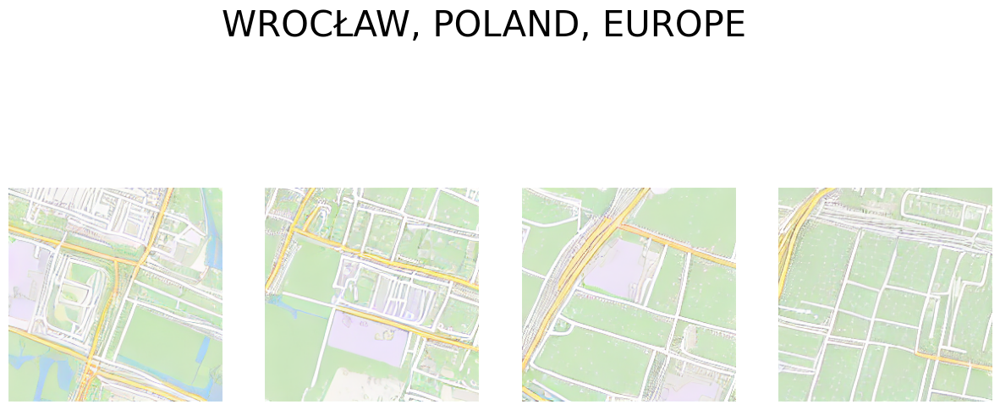

  0%|          | 0/50 [00:00<?, ?it/s]

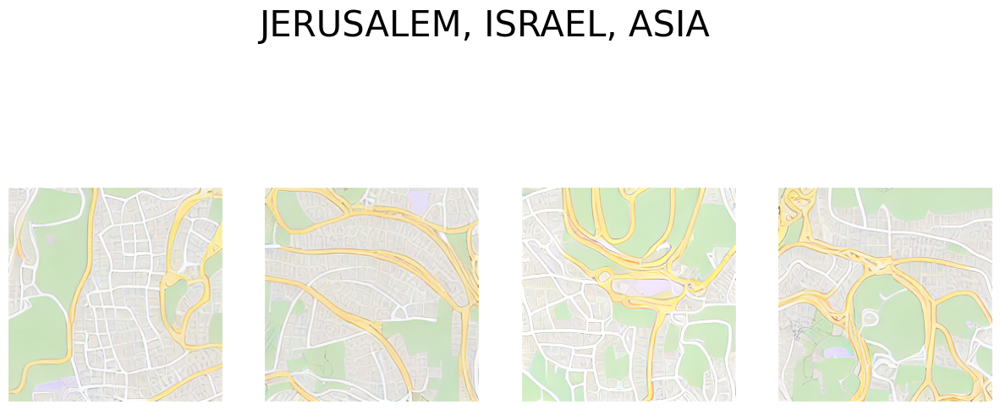

  0%|          | 0/50 [00:00<?, ?it/s]

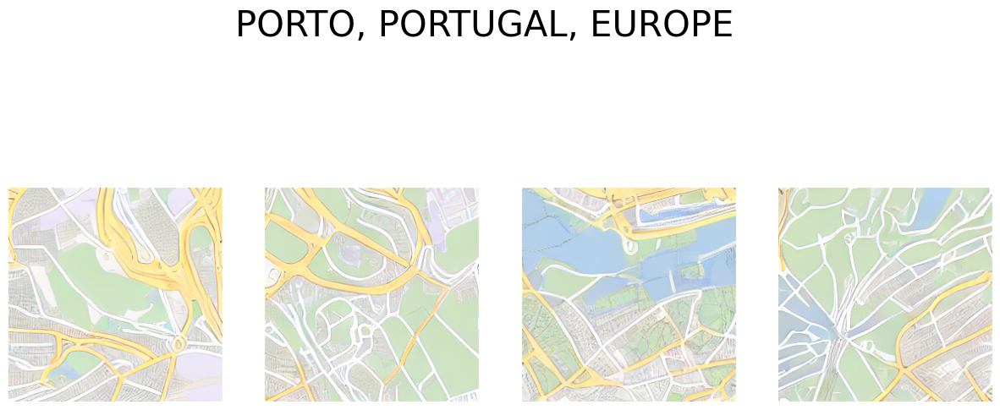

  0%|          | 0/50 [00:00<?, ?it/s]

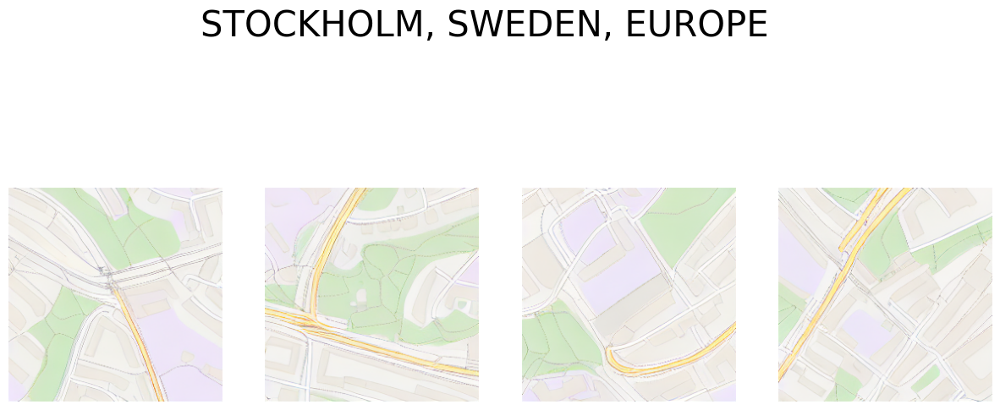

  0%|          | 0/50 [00:00<?, ?it/s]

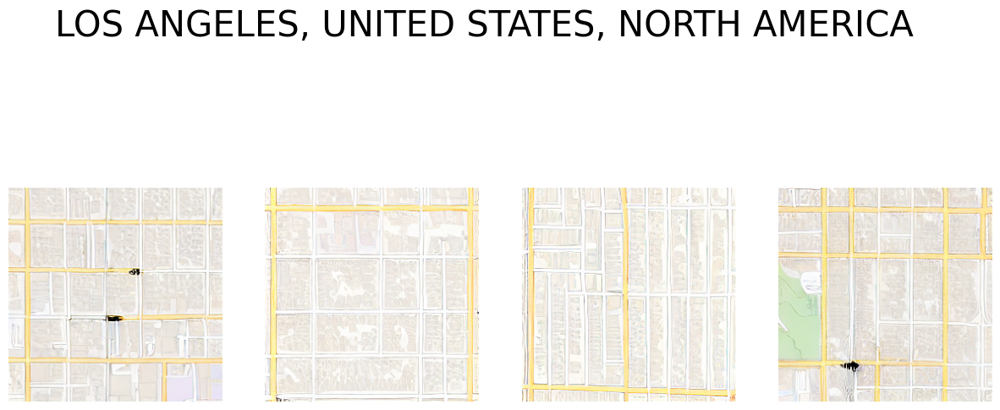

In [15]:
print(sentences[1])
display(Image.open(requests.get(jerusalem[2], stream=True).raw))
compare_area_types(sentences[1], cities)

OSM from {area_type} of suburb area containing: 1 shop seafood, 1 shop houseware, 6 building kiosks , 61 amenity restaurants , 2 amenity bicycle parkings , 1 shop bicycle, 6 tourism informations , 6 historic memorials , 1 shop butcher, 1 shop coffee.


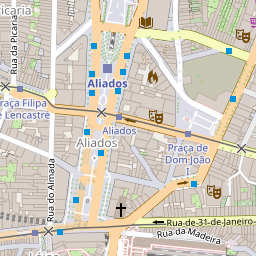

  0%|          | 0/50 [00:00<?, ?it/s]

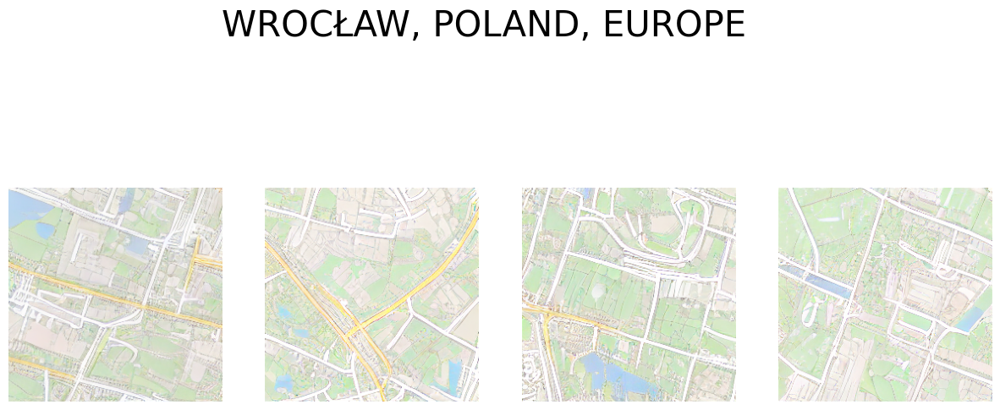

  0%|          | 0/50 [00:00<?, ?it/s]

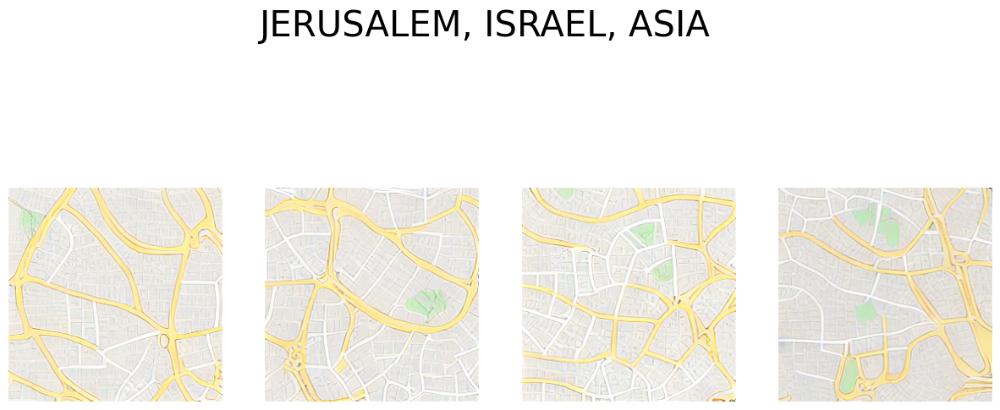

  0%|          | 0/50 [00:00<?, ?it/s]

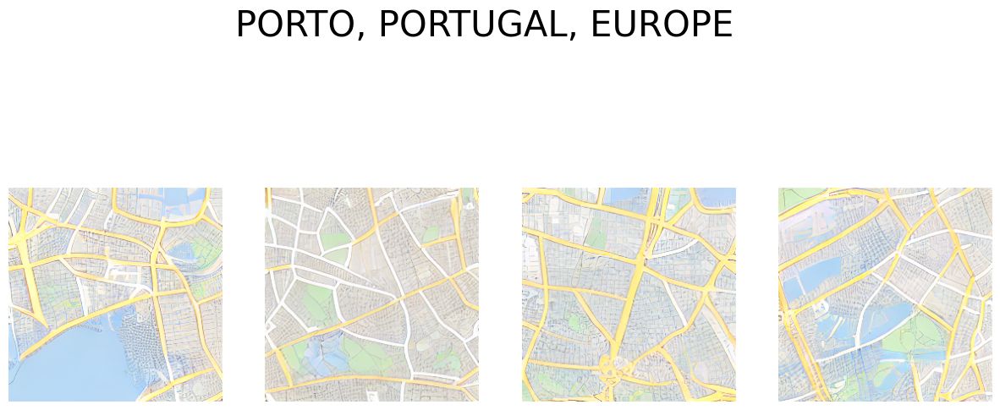

  0%|          | 0/50 [00:00<?, ?it/s]

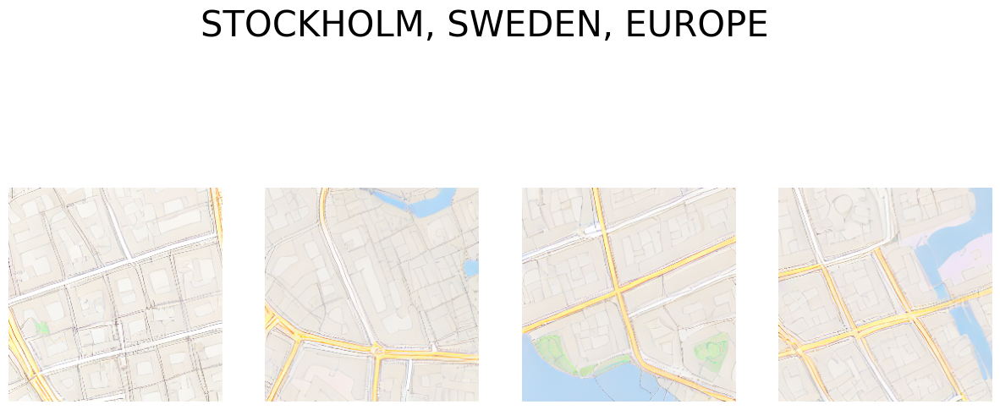

  0%|          | 0/50 [00:00<?, ?it/s]

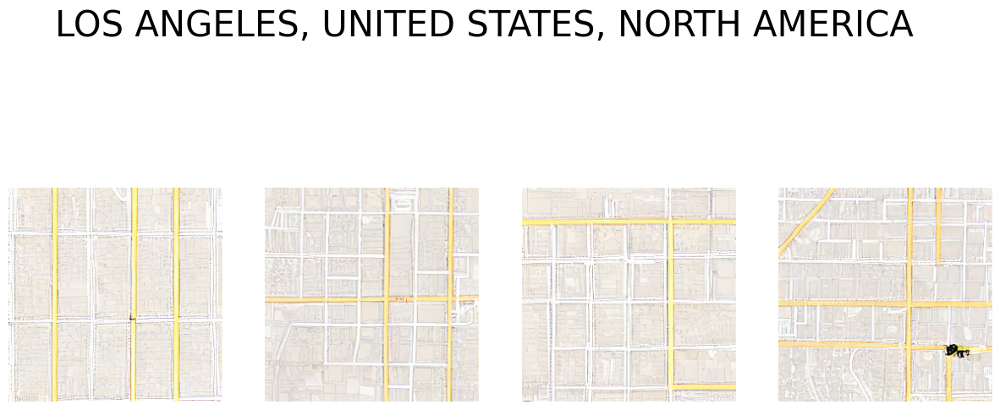

In [16]:
print(sentences[2])
display(Image.open(requests.get(porto[2], stream=True).raw))
compare_area_types(sentences[2], cities)

OSM from {area_type} of suburb area containing: 1 amenity events venue, 2 amenity parking spaces , 2 highway unclassifieds , 8 highway residentials , 3 highway turning circles , 17 buildings , 3 amenity parkings , 11 building sheds , 1 leisure playground, 1 leisure garden.


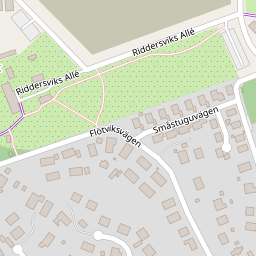

  0%|          | 0/50 [00:00<?, ?it/s]

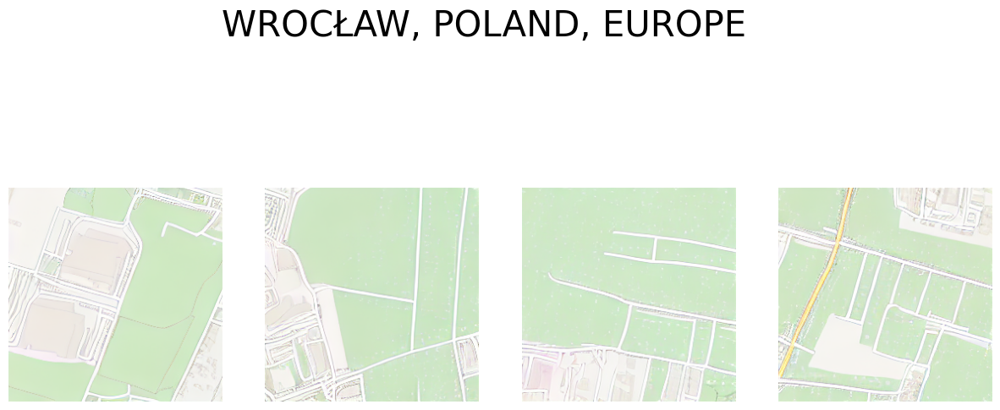

  0%|          | 0/50 [00:00<?, ?it/s]

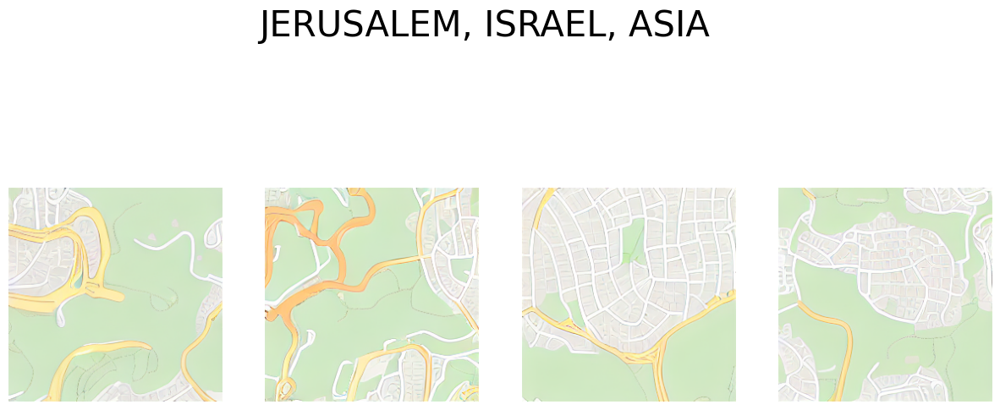

  0%|          | 0/50 [00:00<?, ?it/s]

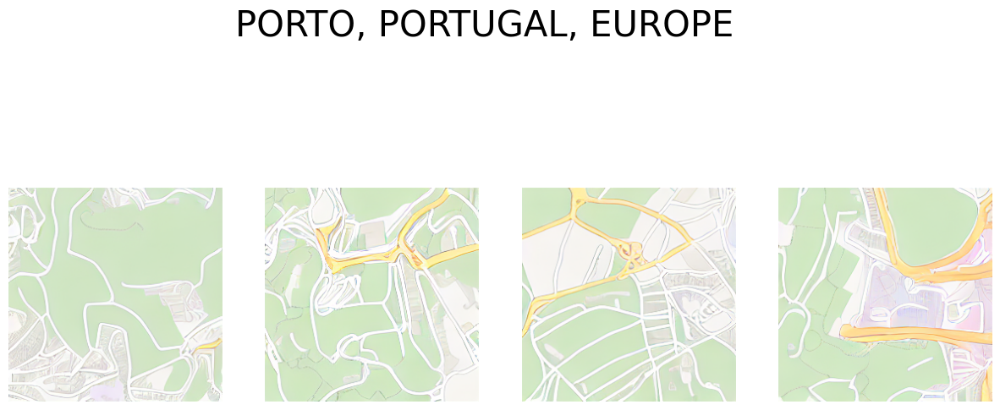

  0%|          | 0/50 [00:00<?, ?it/s]

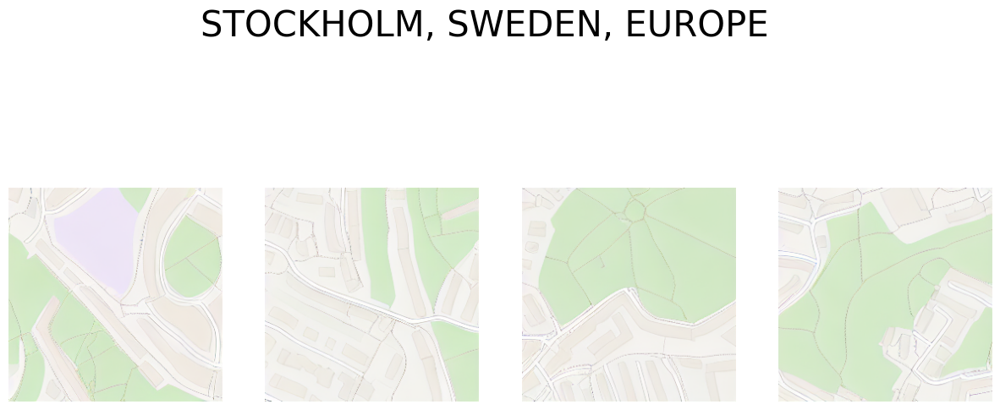

  0%|          | 0/50 [00:00<?, ?it/s]

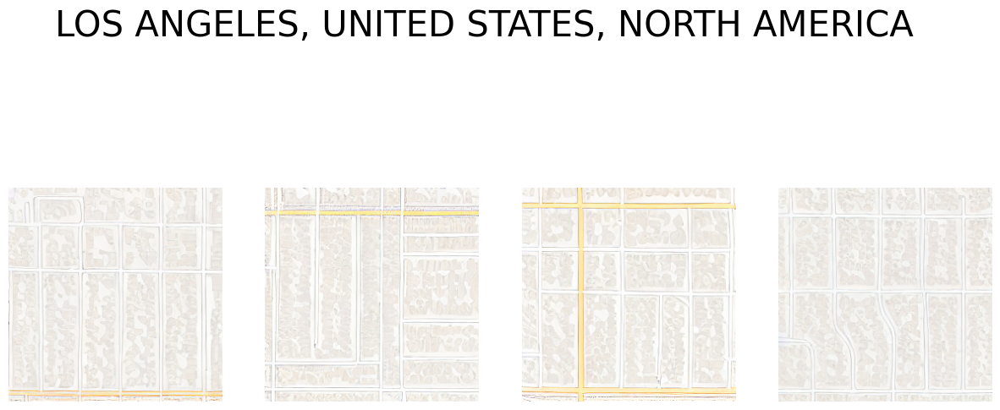

In [17]:
print(sentences[3])
display(Image.open(requests.get(stockholm[2], stream=True).raw))
compare_area_types(sentences[3], cities)

OSM from {area_type} of area containing: 1 natural coastline, 4 leisure parks , 38 building residentials , 1 leisure marina, 194 building houses , 18 building apartmentss , 6 leisure pitchs , 24 highway paths , 2 natural waters , 1 waterway canal.


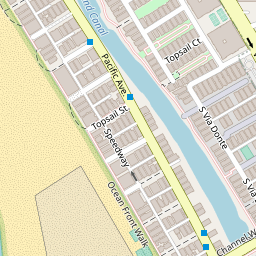

  0%|          | 0/50 [00:00<?, ?it/s]

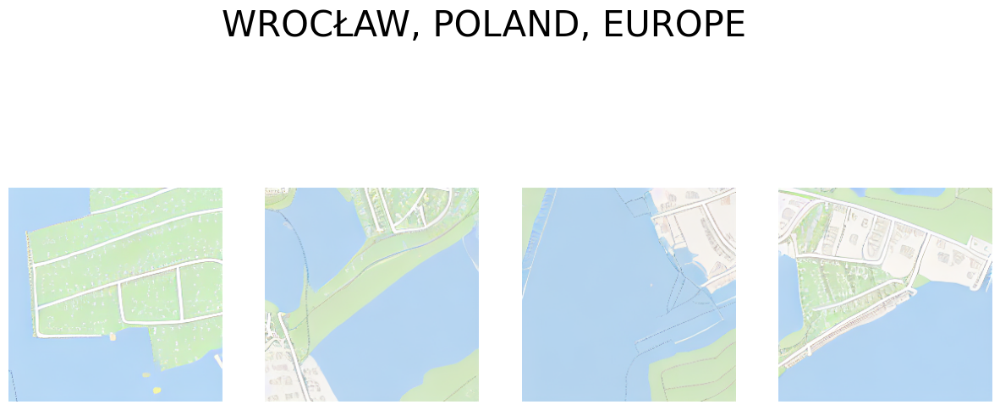

  0%|          | 0/50 [00:00<?, ?it/s]

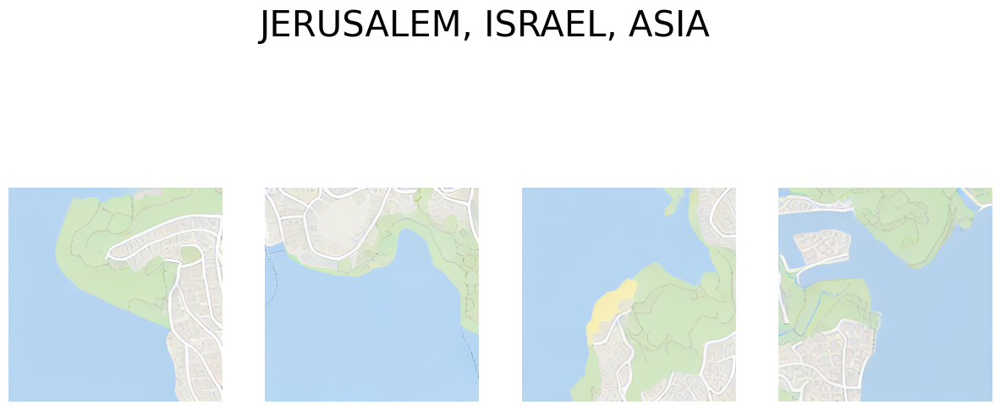

  0%|          | 0/50 [00:00<?, ?it/s]

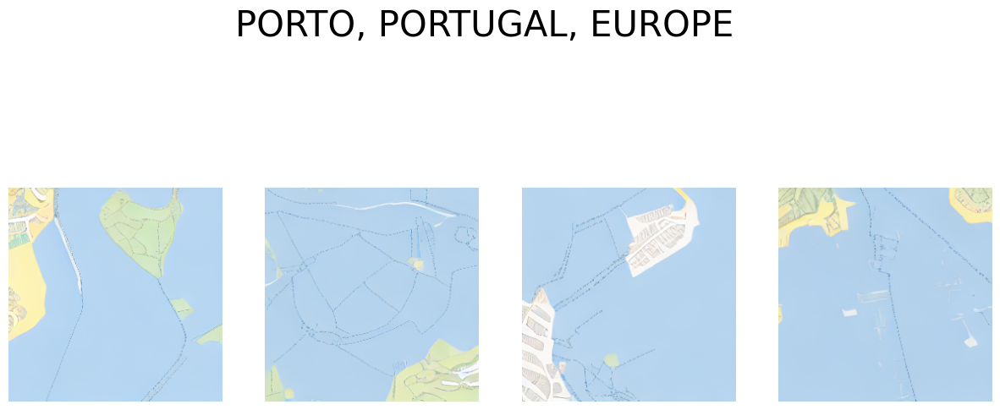

  0%|          | 0/50 [00:00<?, ?it/s]

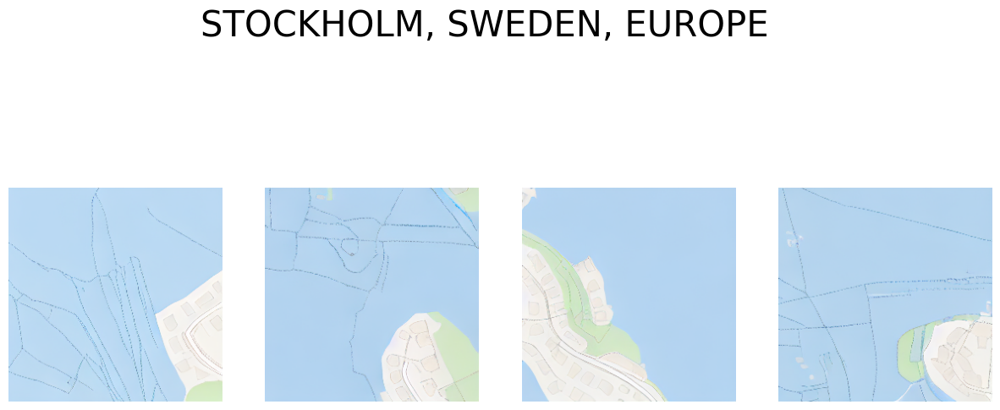

  0%|          | 0/50 [00:00<?, ?it/s]

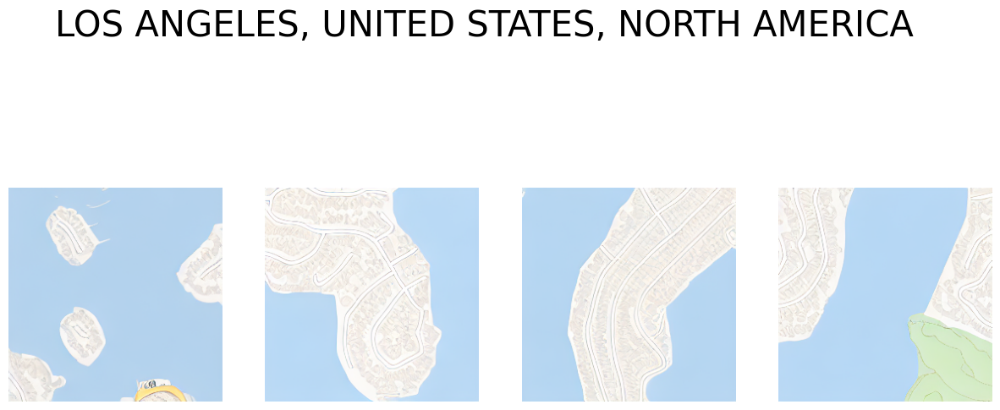

In [18]:
print(sentences[4])
display(Image.open(requests.get(la[2], stream=True).raw))
compare_area_types(sentences[4], cities)

OSM from {area_type} of suburb area containing: 1 landuse brownfield,  8 highway , 11 building sheds , 5 highway footways , 2 amenity parking spaces , 1 leisure playground, 7 highway services , 3 landuse forests .


  0%|          | 0/50 [00:00<?, ?it/s]

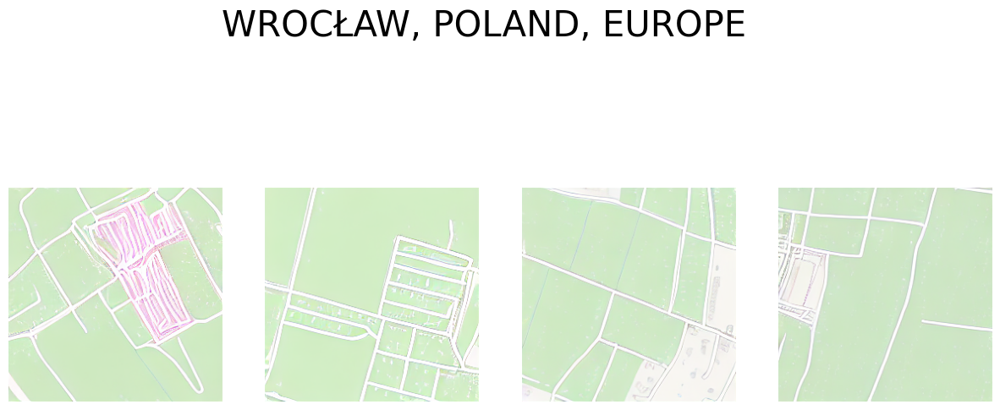

  0%|          | 0/50 [00:00<?, ?it/s]

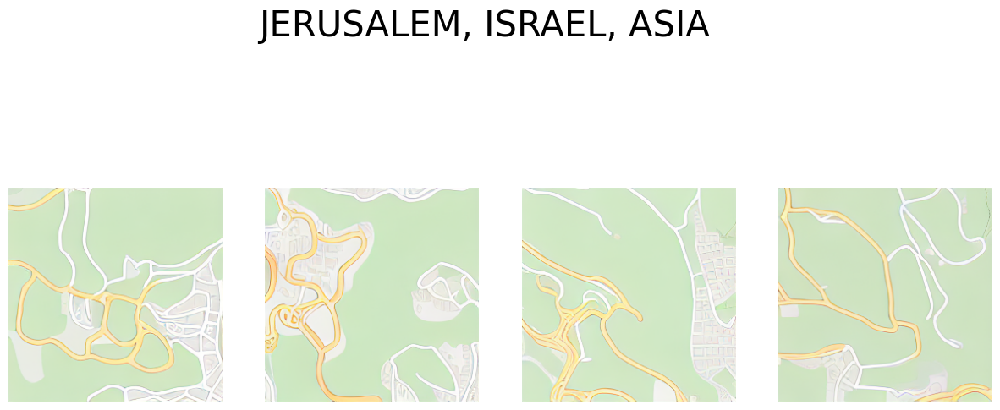

  0%|          | 0/50 [00:00<?, ?it/s]

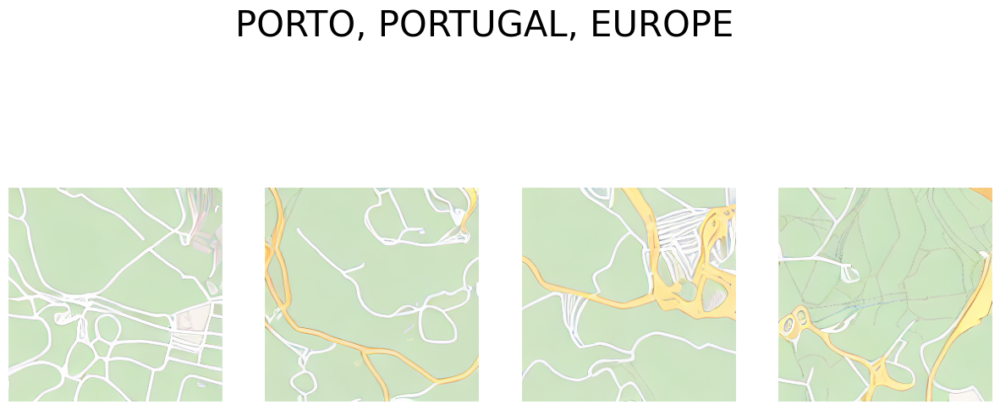

  0%|          | 0/50 [00:00<?, ?it/s]

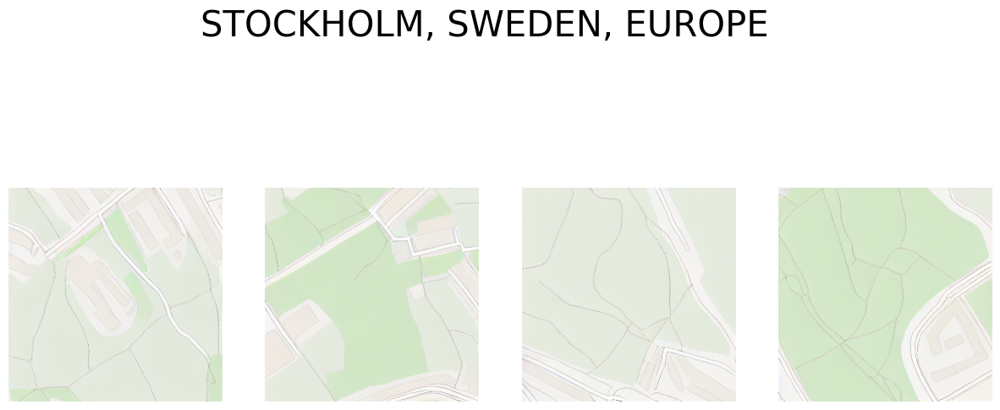

  0%|          | 0/50 [00:00<?, ?it/s]

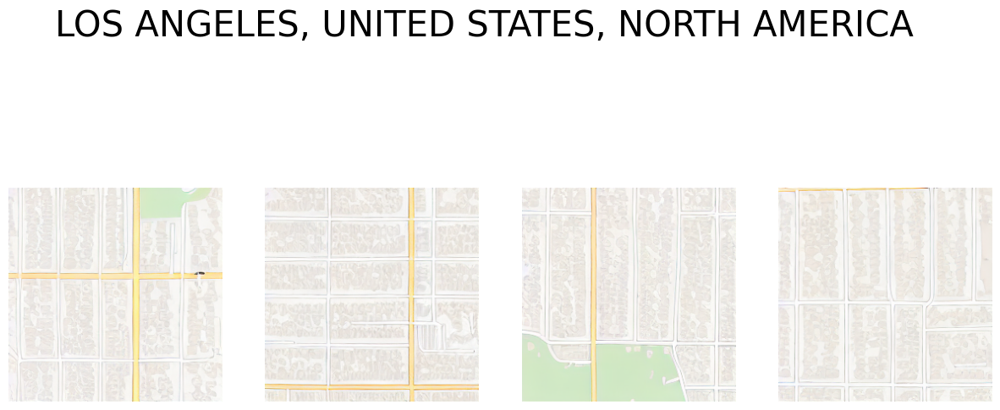

In [19]:
prompt = "OSM from {area_type} of suburb area containing: 1 landuse brownfield,  8 highway , 11 building sheds , 5 highway footways , 2 amenity parking spaces , 1 leisure playground, 7 highway services , 3 landuse forests ."
print(prompt)
compare_area_types(prompt, cities)

# Miksowanie typu miejsca

  0%|          | 0/50 [00:00<?, ?it/s]

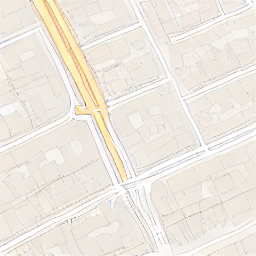

In [20]:
pipe(prompt=sentences[0].format(area_type="Los Angeles, Denmark, Europe")).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

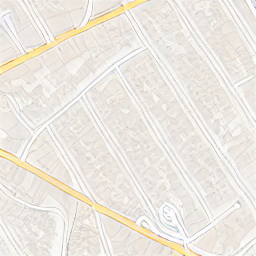

In [21]:
pipe(prompt=sentences[0].format(area_type="Los Angeles, USA, Europe")).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

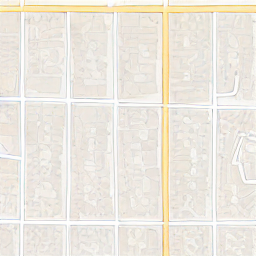

In [22]:
pipe(prompt=sentences[0].format(area_type="Los Angeles, USA, North America")).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

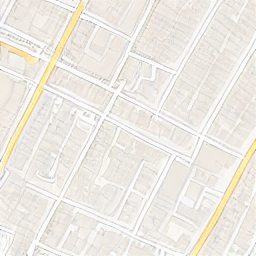

In [23]:
pipe(prompt=sentences[0].format(area_type="Los Angeles, Poland, Europe")).images[0]

# Area types

In [24]:
cities_dict = {}
def read_city(admin):
    df = pd.read_pickle(f"../data/admins/{admin}")
    return df.groupby("name").count()["admin_region"]

for admin in os.listdir("../data/admins/"):
    df = read_city(admin)
    cities_dict[admin] = df.shape[0]
    


In [25]:
data = pd.Series(data=cities_dict)
data[data == data.max()].index.item()

'Kraków, PL.pkl'

In [26]:
area_types = read_city(data[data == data.max()].index.item()).index
area_types

Index(['city', 'city_block', 'hamlet', 'locality', 'neighbourhood', 'quarter',
       'suburb', 'town', 'unknown', 'village'],
      dtype='object', name='name')

  0%|          | 0/50 [00:00<?, ?it/s]

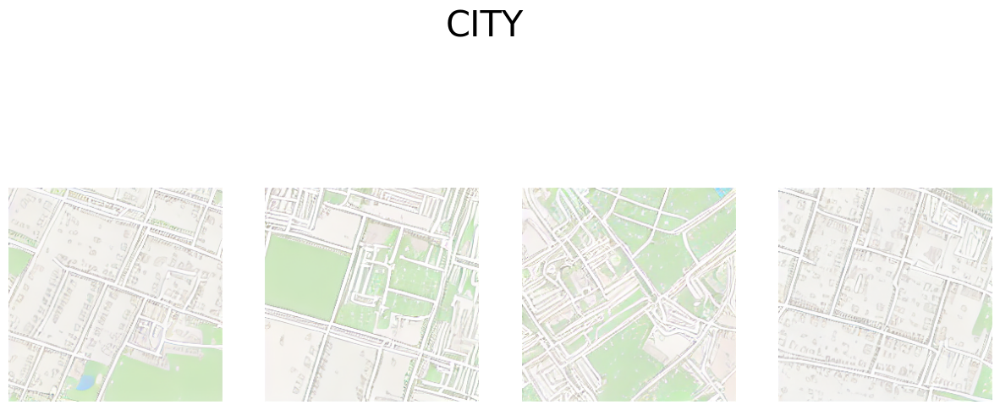

  0%|          | 0/50 [00:00<?, ?it/s]

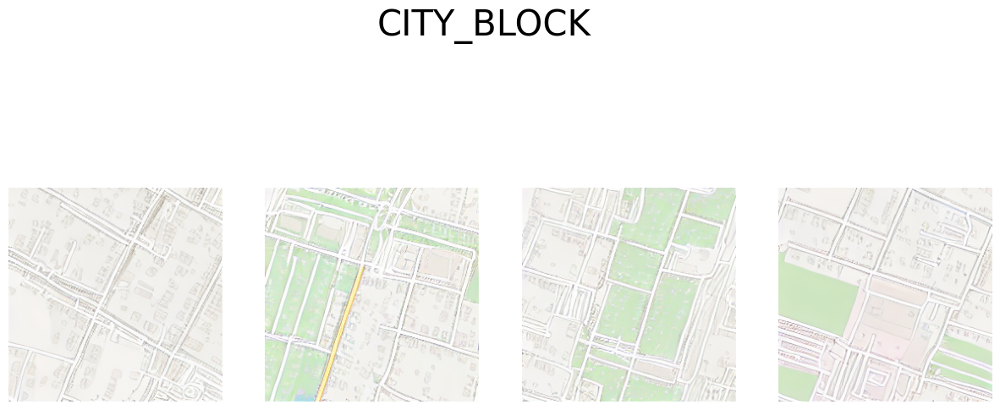

  0%|          | 0/50 [00:00<?, ?it/s]

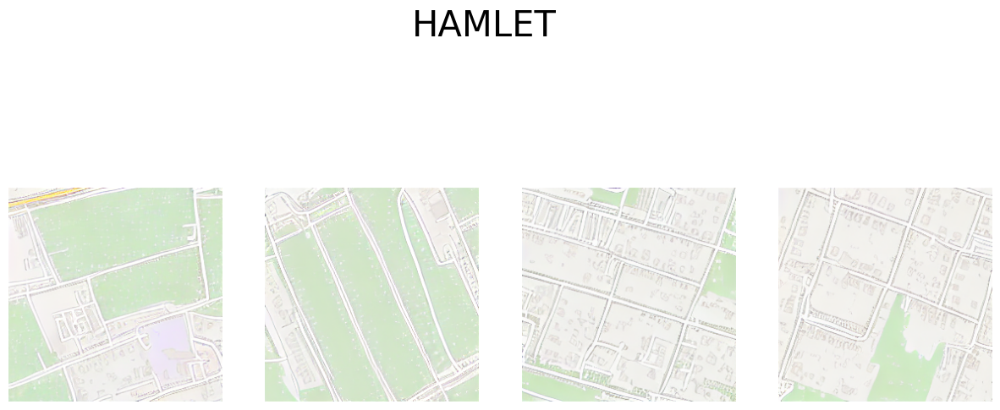

  0%|          | 0/50 [00:00<?, ?it/s]

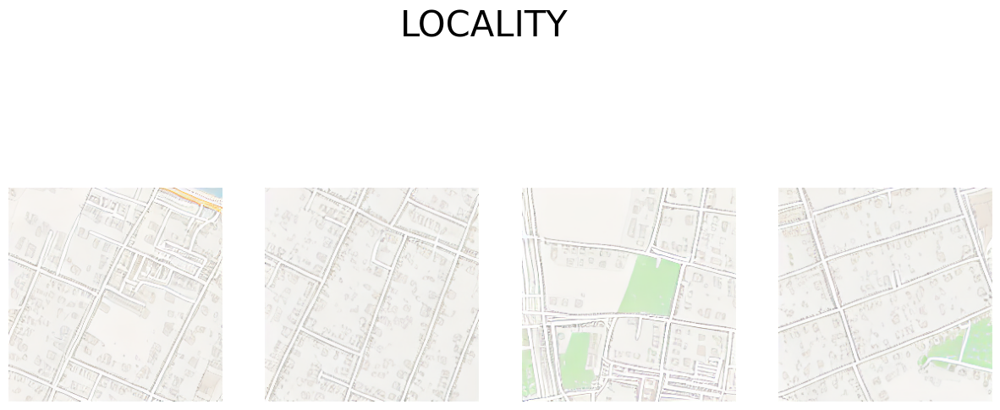

  0%|          | 0/50 [00:00<?, ?it/s]

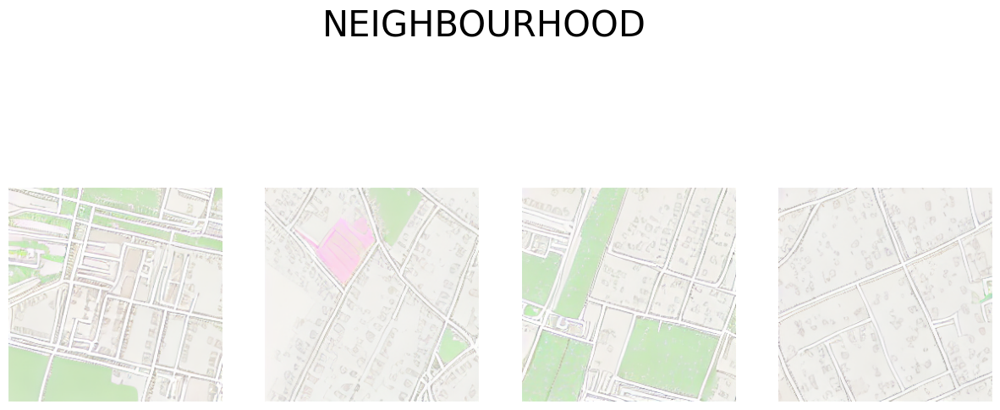

  0%|          | 0/50 [00:00<?, ?it/s]

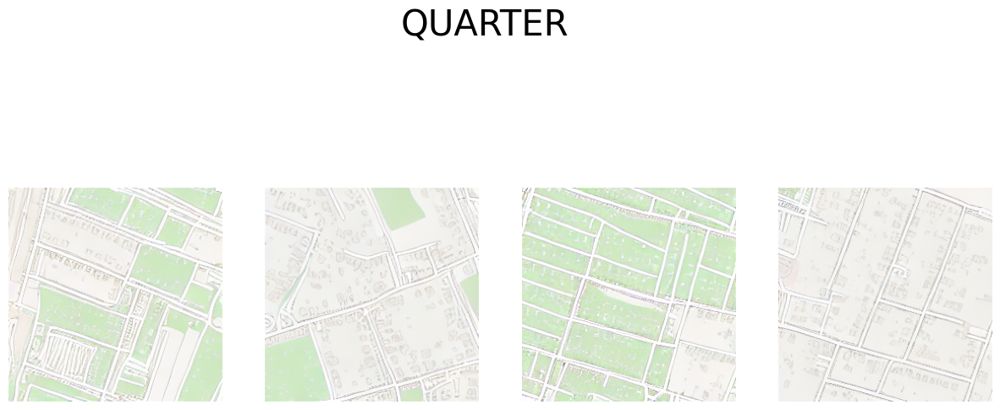

  0%|          | 0/50 [00:00<?, ?it/s]

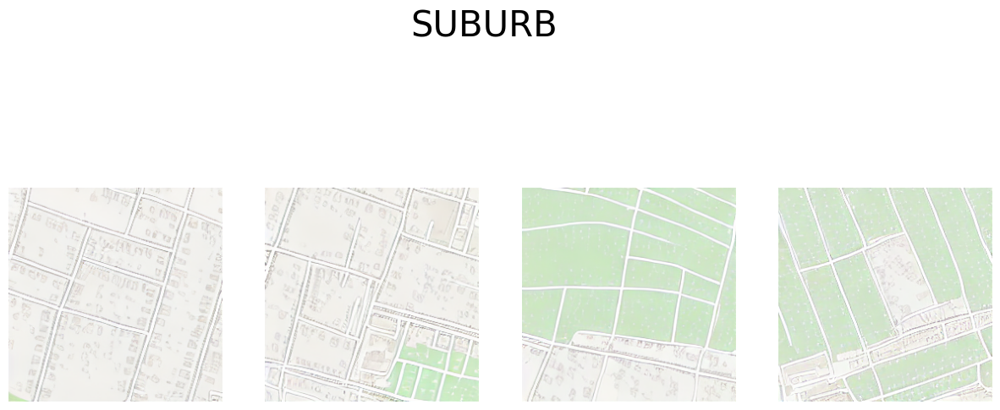

  0%|          | 0/50 [00:00<?, ?it/s]

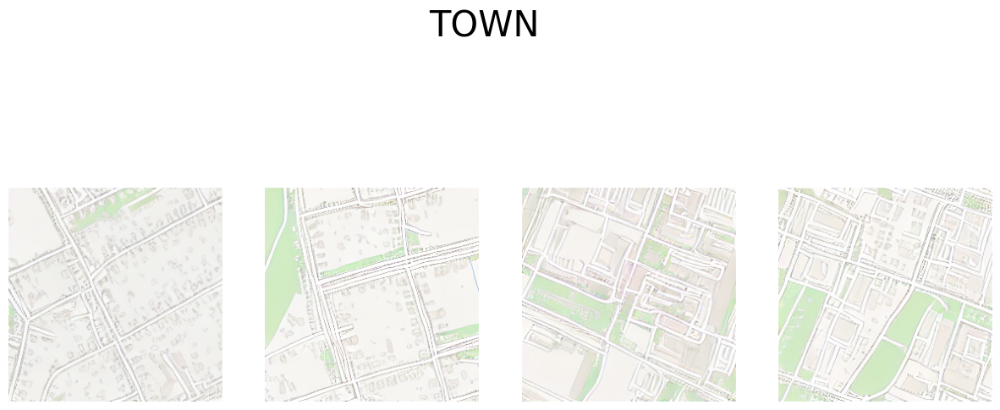

  0%|          | 0/50 [00:00<?, ?it/s]

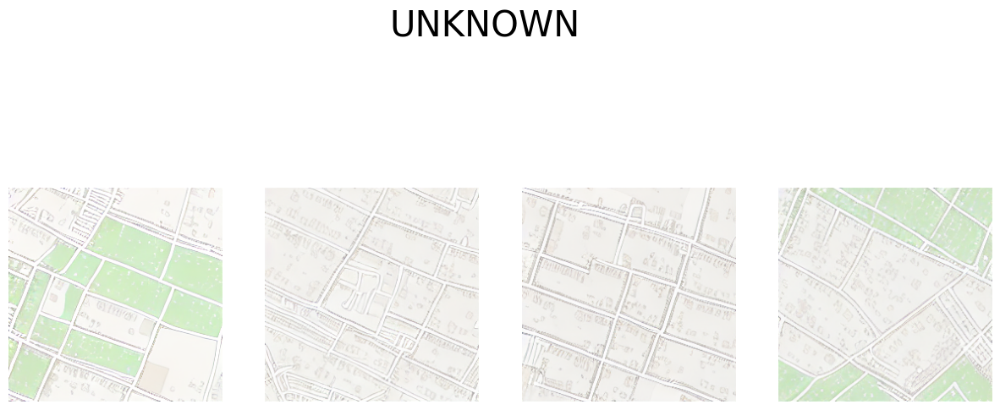

  0%|          | 0/50 [00:00<?, ?it/s]

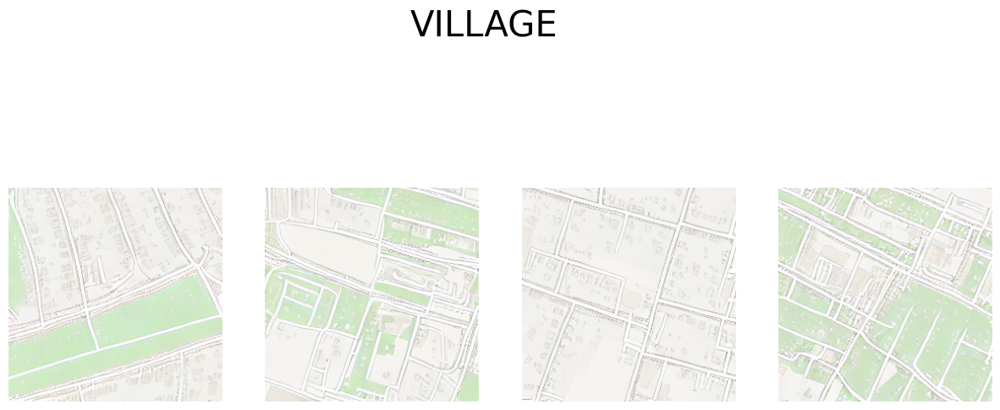

In [27]:
prompt_template = "OSM from Wrocław, Poland, Europe of {area_type} area containing: 6 building retails , 37 building residentials , 14 buildings , 7 highway services , 1 landuse religious."

compare_area_types(prompt_template, to_put=area_types)